# WorldBank Data 

## Dependencies

In [1]:
# Set project directory
import os
import sys


def project_dir():
    notebook_path = %pwd
    repo_name = "/worldbank_data_exploration/"
    repo_folder = notebook_path.split(repo_name)[0]
    return os.path.join(repo_folder, repo_name[1:])


pwd = os.getenv("PWD", project_dir())
os.environ["PWD"] = pwd
sys.path.append(pwd)

In [2]:
import warnings

warnings.simplefilter("ignore", category=UserWarning)

In [3]:
import numpy as np
import pandas as pd
import seaborn as sb

from helpers import run_and_measure
from pandas import DataFrame
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import normalize
from sklearn.manifold import MDS
from matplotlib import pyplot as plt

from data_sources.get import get_indicators
from data_sources.load_dataset import load_dataset, split_by_columns
from data_sources.preprocessing import preprocess_df
from metrics.similarity import SimilarityBuilder

During startup - Warning messages:
1: Setting LC_COLLATE failed, using "C" 
2: Setting LC_TIME failed, using "C" 
3: Setting LC_MESSAGES failed, using "C" 
4: Setting LC_MONETARY failed, using "C" 


## Dataset

In [4]:
df = load_dataset()
df

Indicator Name       Access to electricity (% of population)  \
Year Country Name                                              
2000 Albania                                      100.000000   
     Angola                                        20.000000   
     Australia                                    100.000000   
     Austria                                      100.000000   
     Azerbaijan                                    98.908222   
...                                                      ...   
2020 Uganda                                        41.300000   
     Ukraine                                      100.000000   
     United Kingdom                               100.000000   
     United States                                100.000000   
     Uruguay                                       99.900000   

Indicator Name       Agriculture, forestry, and fishing, value added (% of GDP)  \
Year Country Name                                                                 
2000 Albania                                                 24.515412            
     Angola                                                   5.664690            
     Australia                                                3.114903            
     Austria                                                  1.647300            
     Azerbaijan                                              16.084865            
...                                                                ...            
2020 Uganda                                                  23.929034            
     Ukraine                                                  9.266236            
     United Kingdom                                           0.581796            
     United States                                            0.916865            
     Uruguay                                                  7.481413            

Indicator Name       Exports of goods and services (% of GDP)  \
Year Country Name                                               
2000 Albania                                        20.115286   
     Angola                                         89.685831   
     Australia                                      19.418124   
     Austria                                        43.346274   
     Azerbaijan                                     40.170831   
...                                                       ...   
2020 Uganda                                         15.414799   
     Ukraine                                        39.061358   
     United Kingdom                                 28.120834   
     United States                                  10.134143   
     Uruguay                                        25.373271   

Indicator Name       Fertility rate, total (births per woman)  \
Year Country Name                                               
2000 Albania                                            2.157   
     Angola                                             6.639   
     Australia                                          1.756   
     Austria                                            1.360   
     Azerbaijan                                         2.000   
...                                                       ...   
2020 Uganda                                             4.703   
     Ukraine                                            1.434   
     United Kingdom                                     1.743   
     United States                                      1.772   
     Uruguay                                            1.952   

Indicator Name       Forest area (% of land area)  GDP growth (annual %)  \
Year Country Name                                                          
2000 Albania                            28.076642               6.946217   
     Angola                             62.331443               3.054624   
     Australia                          17.158156               3.912428   
     Austria   

In [5]:
df.shape

(1953, 15)

In [6]:
print(df.isna().any())

Indicator Name
Access to electricity (% of population)                                False
Agriculture, forestry, and fishing, value added (% of GDP)             False
Exports of goods and services (% of GDP)                               False
Fertility rate, total (births per woman)                               False
Forest area (% of land area)                                           False
GDP growth (annual %)                                                  False
Inflation, consumer prices (annual %)                                  False
Life expectancy at birth, total (years)                                False
Merchandise trade (% of GDP)                                           False
Military expenditure (% of GDP)                                        False
Mortality rate, under-5 (per 1,000 live births)                        False
Population growth (annual %)                                           False
Population in the largest city (% of urban population)       

In [7]:
frames = split_by_columns(df)

# TS-Dist


### TSdist Package:

In [8]:
from rpy2.robjects.packages import importr

ts = importr("TSdist")
print(dir(ts))

['ACFDistance', 'ARLPCCepsDistance', 'ARMahDistance', 'ARMahPvalueDistance', 'ARMahStatisticDistance', 'ARPicDistance', 'CCInitialCheck', 'CCorDistance', 'CDMDistance', 'CIDDistance', 'ConvertMatrix', 'CorDistance', 'CortDistance', 'DTWDistance', 'DissimDistance', 'DissimInitialCheck', 'EDRDistance', 'EDRInitialCheck', 'ERPDistance', 'ERPInitialCheck', 'EuclideanDistance', 'F', 'FInitialCheck', 'FourierDistance', 'FrechetDistance', 'InfNormDistance', 'IntPerDistance', 'KMedoids', 'L1dist', 'LBKeoghDistance', 'LCSSDistance', 'LCSSInitialCheck', 'LPDistance', 'LPInitialCheck', 'ManhattanDistance', 'MatrixToList', 'MindistSaxDistance', 'MinkowskiDistance', 'NCDDistance', 'OneNN', 'PACFDistance', 'PDCDist2', 'PDCDistance', 'PairwiseARLPCCepsDistance', 'PairwiseARPicDistance', 'PairwiseCDMDistance', 'PairwiseDistances1', 'PairwiseDistances2', 'PairwiseFrechetDistance', 'PairwiseInterpSpecDistance', 'PairwiseNCDDistance', 'PairwisePredDistance', 'PairwiseSpecGLKDistance', 'PairwiseSpecISDDis

### Single metric:

In [9]:
from metrics.rbind import tsdist

In [10]:
indicator, frame = list(frames.items())[0]
frame

Country Name,Albania,Angola,Australia,Austria,Azerbaijan,Bangladesh,Belarus,Belgium,Bolivia,Brazil,...,Sweden,Switzerland,Tanzania,Thailand,Tunisia,Uganda,Ukraine,United Kingdom,United States,Uruguay
Year,,,,,,,,,,,,,,,,,,,,,
2000,100.00,20.000000,100.0,100.0,98.908222,32.000000,100.0,100.0,69.963045,94.364006,...,100.0,100.0,9.056112,82.100000,94.8,7.318620,100.000000,100.0,100.0,97.551483
2001,100.00,20.000000,100.0,100.0,98.623421,35.109272,100.0,100.0,69.258539,96.016528,...,100.0,100.0,9.996444,90.453430,97.3,8.600000,100.000000,100.0,100.0,97.700745
2002,100.00,26.383869,100.0,100.0,100.000000,37.881958,100.0,100.0,63.996855,96.652996,...,100.0,100.0,10.928488,91.108299,97.8,7.800000,100.000000,100.0,100.0,97.841713
2003,100.00,27.465635,100.0,100.0,98.977852,40.645180,100.0,100.0,72.300000,96.980098,...,100.0,100.0,11.100000,91.753708,98.4,10.628203,100.000000,100.0,100.0,97.973221
2004,100.00,28.536760,100.0,100.0,99.139694,40.600000,100.0,100.0,76.044250,96.765107,...,100.0,100.0,11.400000,92.388474,99.0,11.711685,100.000000,100.0,100.0,98.094093
2005,100.00,29.596224,100.0,100.0,99.289879,44.230000,100.0,100.0,68.288209,97.093513,...,100.0,100.0,13.663281,93.011574,99.3,8.900000,99.885562,100.0,100.0,98.203293
2006,100.00,30.646555,100.0,100.0,99.500000,50.525102,100.0,100.0,76.211281,97.594314,...,100.0,100.0,14.554425,99.146201,99.4,9.000000,100.000000,100.0,100.0,98.505426
2007,100.00,37.500000,100.0,100.0,99.568916,46.500000,100.0,100.0,80.156567,98.125382,...,100.0,100.0,15.442517,94.236465,99.4,14.905825,99.800000,100.0,100.0,98.692636
2008,100.00,38.490000,100.0,100.0,99.710106,54.331120,100.0,100.0,84.674991,98.526625,...,100.0,100.0,11.500000,94.850563,99.4,15.968645,100.000000,100.0,100.0,98.784355


In [11]:
indicator

'Access to electricity (% of population)'

In [12]:
frame.shape

(21, 93)

In [13]:
corr = frame.corr(method=tsdist("DTWDistance"))

In [14]:
corr.shape

(93, 93)

In [15]:
corr

Country Name,Albania,Angola,Australia,Austria,Azerbaijan,Bangladesh,Belarus,Belgium,Bolivia,Brazil,...,Sweden,Switzerland,Tanzania,Thailand,Tunisia,Uganda,Ukraine,United Kingdom,United States,Uruguay
Country Name,,,,,,,,,,,,,,,,,,,,,
Albania,1.000000,2453.411115,0.390000,0.390000,5.987088,997.871164,0.390000,0.390000,418.669085,36.367835,...,0.390000,0.390000,2940.268097,77.290546,18.240000,2856.177668,0.366403,0.390000,0.390000,22.954662
Angola,2453.411115,1.000000,2453.911115,2453.911115,2424.931813,412.111294,2453.911115,2453.911115,1437.336117,2308.103401,...,2453.911115,2453.911115,175.621568,2019.970569,2331.911115,171.104444,2453.264168,2453.911115,2453.911115,2383.536116
Australia,0.390000,2453.911115,1.000000,0.000000,6.574148,998.371164,0.000000,0.000000,419.169085,37.087835,...,0.000000,0.000000,2940.768097,77.940546,18.000000,2856.567668,0.446947,0.000000,0.000000,23.404662
Austria,0.390000,2453.911115,0.000000,1.000000,6.574148,998.371164,0.000000,0.000000,419.169085,37.087835,...,0.000000,0.000000,2940.768097,77.940546,18.000000,2856.567668,0.446947,0.000000,0.000000,23.404662
Azerbaijan,5.987088,2424.931813,6.574148,6.574148,1.000000,969.391862,6.574148,6.574148,390.189783,22.284730,...,6.574148,6.574148,2911.788795,64.878871,9.657426,2830.056722,5.786770,6.574148,6.574148,9.102217
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Uganda,2856.177668,171.104444,2856.567668,2856.567668,2830.056722,737.570605,2856.567668,2856.567668,1885.955051,2721.631941,...,2856.567668,2856.567668,64.724028,2450.627122,2744.967668,1.000000,2856.120721,2856.567668,2856.567668,2790.889702
Ukraine,0.366403,2453.264168,0.446947,0.446947,5.786770,997.724216,0.446947,0.446947,418.522138,36.040888,...,0.446947,0.446947,2940.121150,77.480002,18.046947,2856.120721,1.000000,0.446947,0.446947,23.166048
United Kingdom,0.390000,2453.911115,0.000000,0.000000,6.574148,998.371164,0.000000,0.000000,419.169085,37.087835,...,0.000000,0.000000,2940.768097,77.940546,18.000000,2856.567668,0.446947,1.000000,0.000000,23.404662


[Text(0.5, 1.0, 'Indicator Access to electricity (% of population) Similarity (Metric: DTWDistance)')]

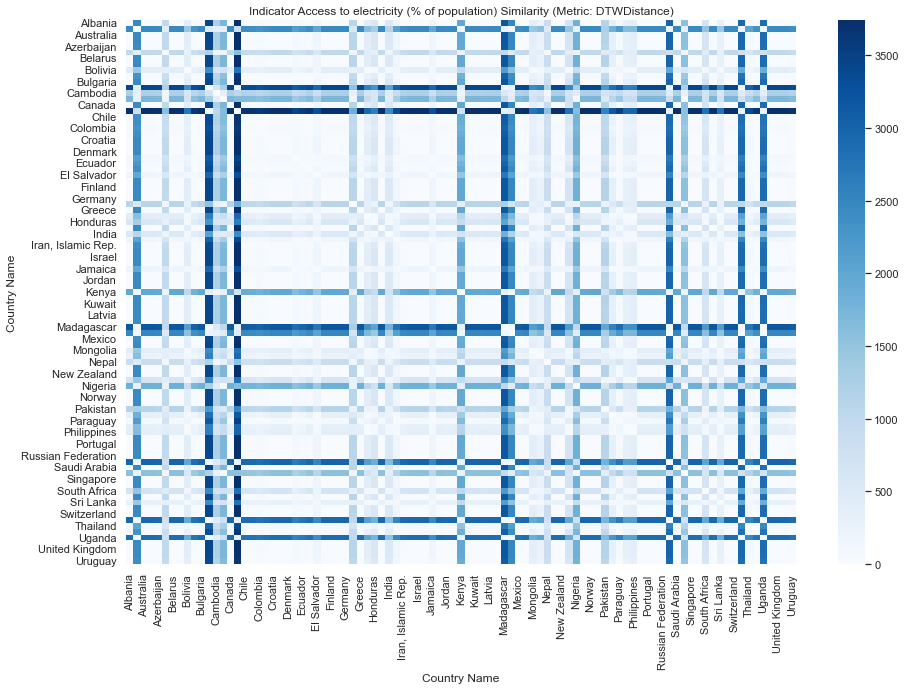

In [16]:
sb.set(rc={"figure.figsize": (15, 10)})
sb.heatmap(corr, cmap="Blues", annot=False).set(
    title=f"Indicator {indicator} Similarity (Metric: DTWDistance)"
)

### Similarity Matrices

In [17]:
sim = SimilarityBuilder()
similarity_matrices = sim.load(df.columns.values)

In [18]:
embedding = MDS(n_components=2)

In [19]:
sb.set(rc={"figure.figsize": (15, 10)})


def plot_sim_matrix(indicator, metric, matrix):
    title = f"Indicator {indicator} Similarity Matrix (Metric: {metric})"
    sb.heatmap(matrix, cmap="Blues", annot=False).set(title=title)
    plt.show()

    transformed = embedding.fit_transform(matrix)
    figure = plt.figure(figsize=(20, 10))
    for i in range(transformed.shape[0]):
        plt.scatter(*transformed[i], label=matrix.index.values[i])
    plt.legend(ncol=3, loc="upper right")
    plt.title(title)
    plt.show()

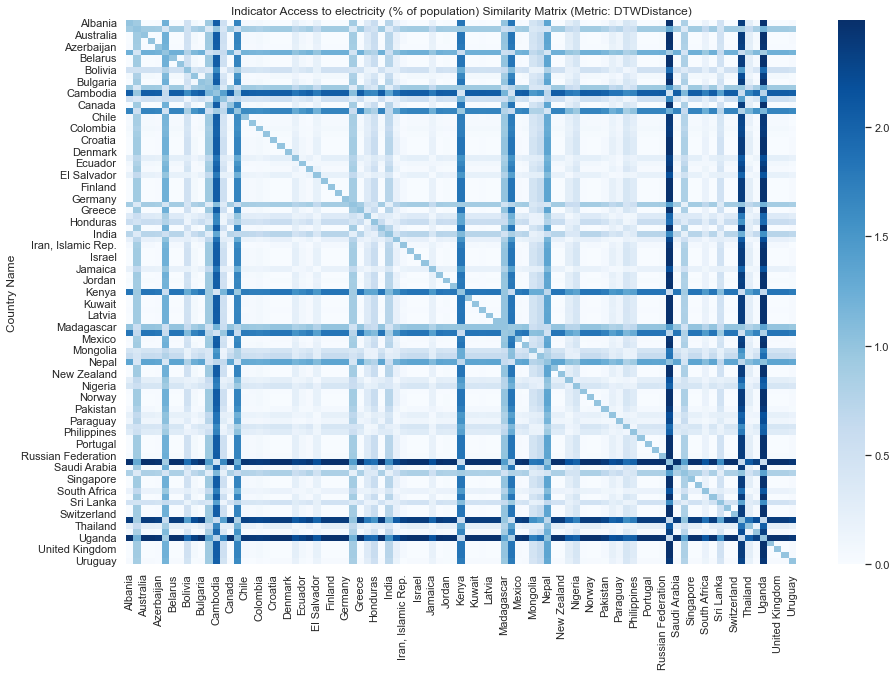

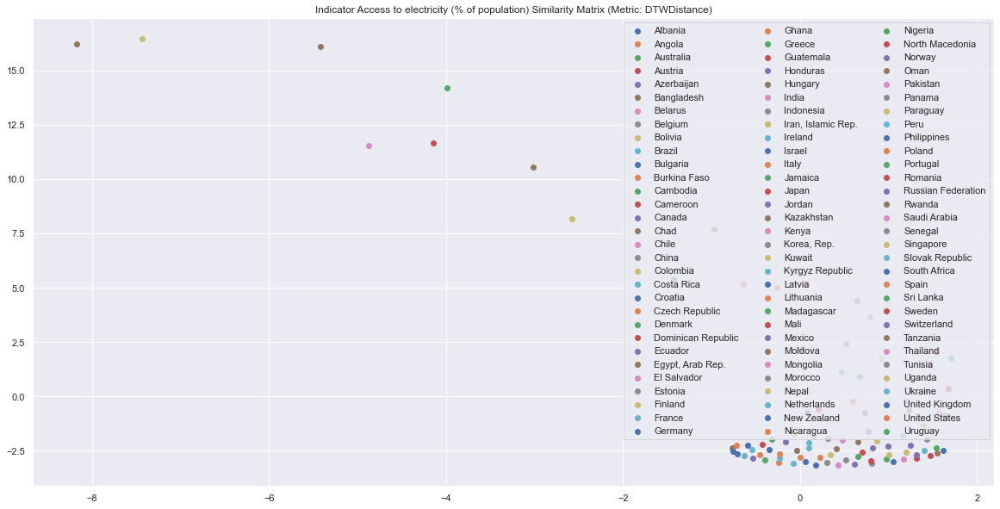

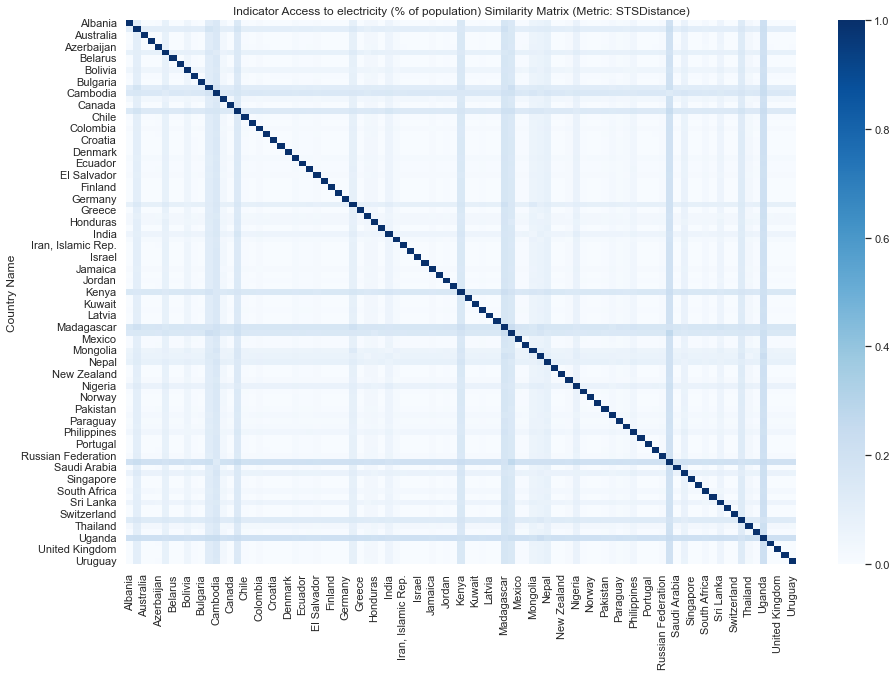

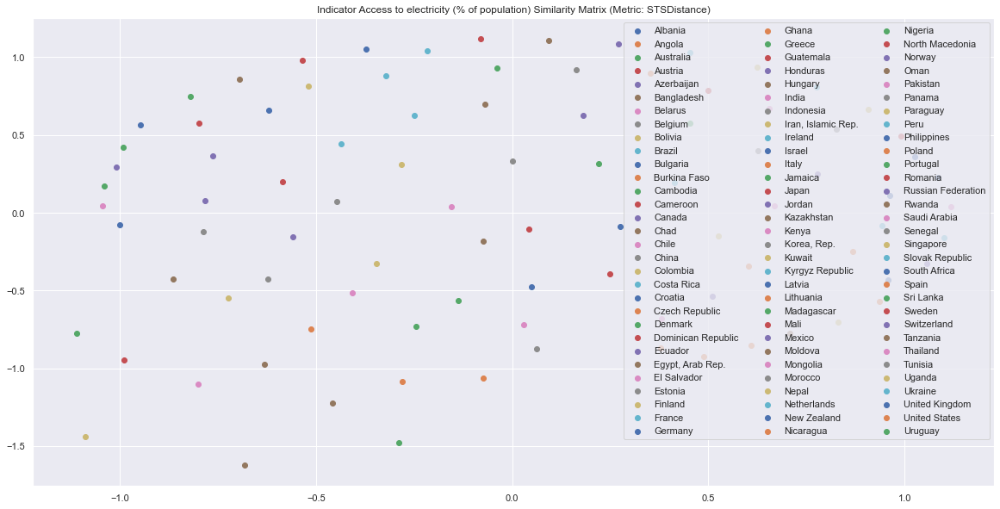

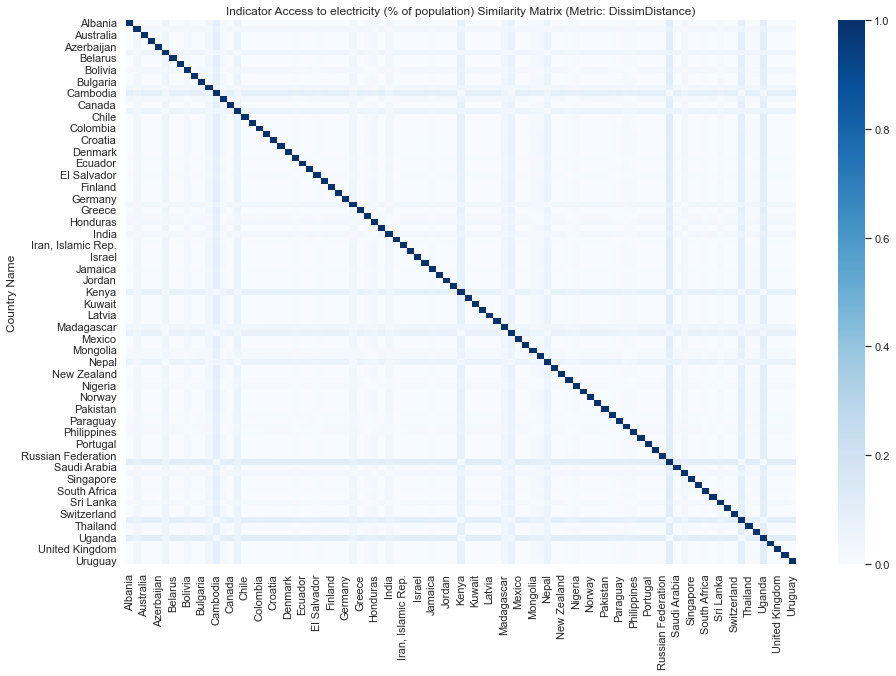

...

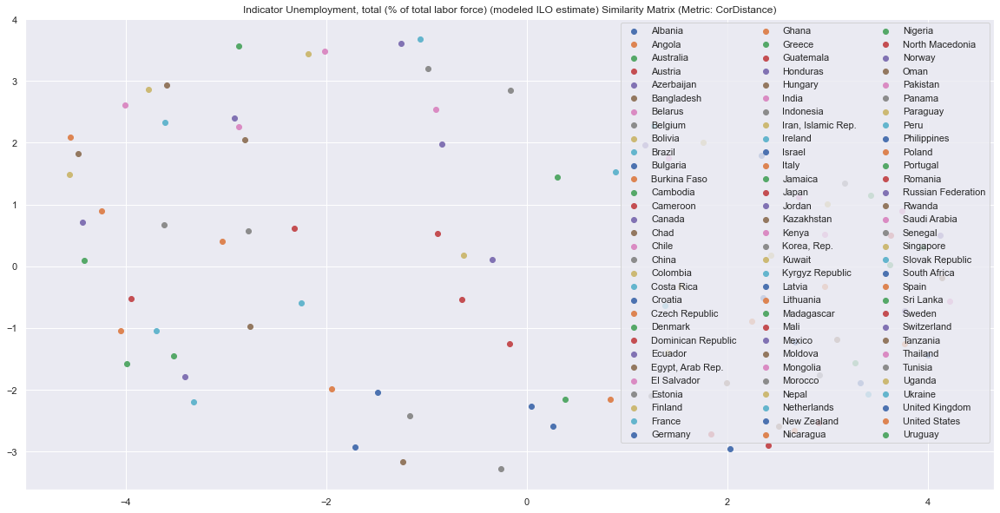

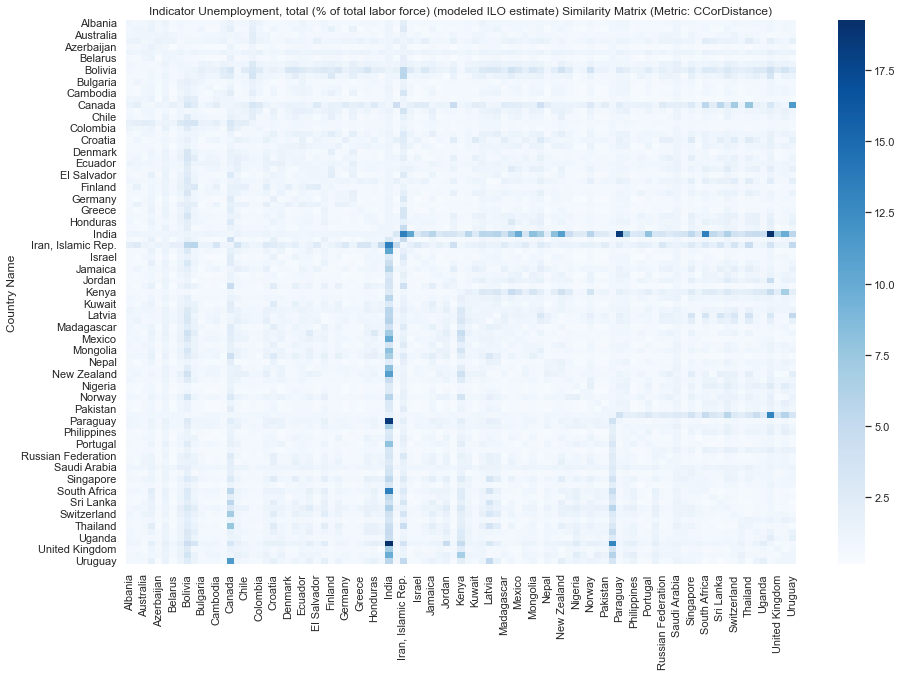

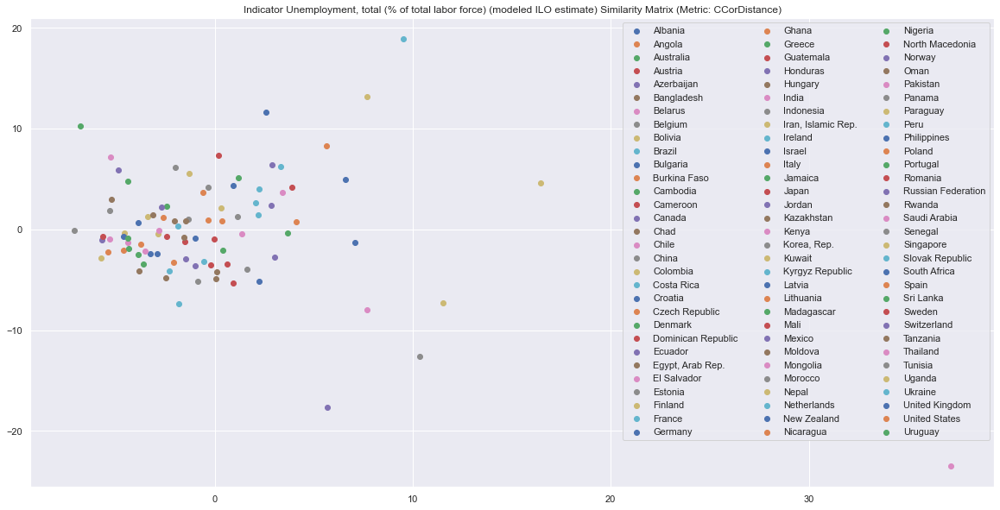

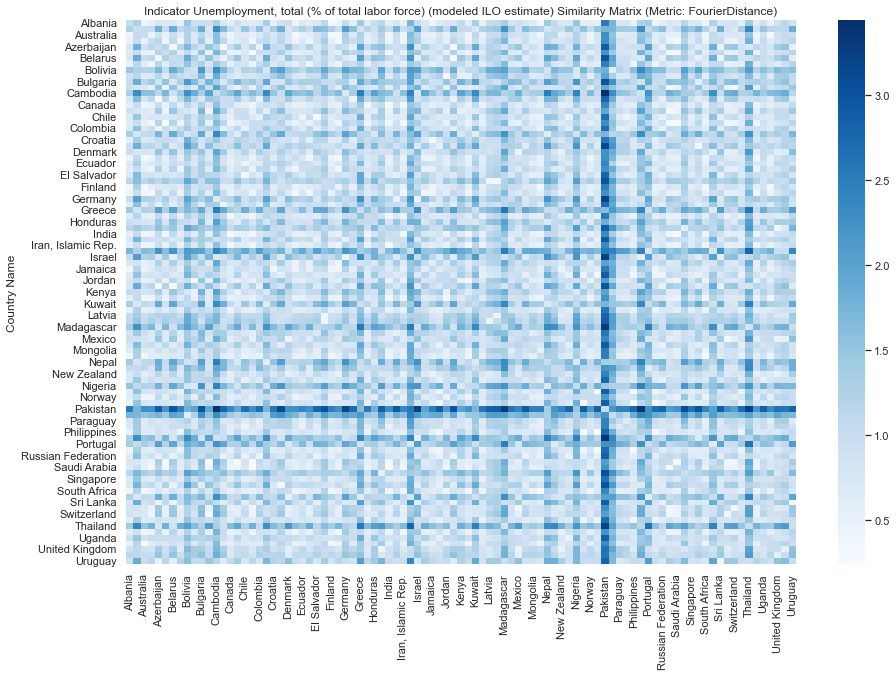

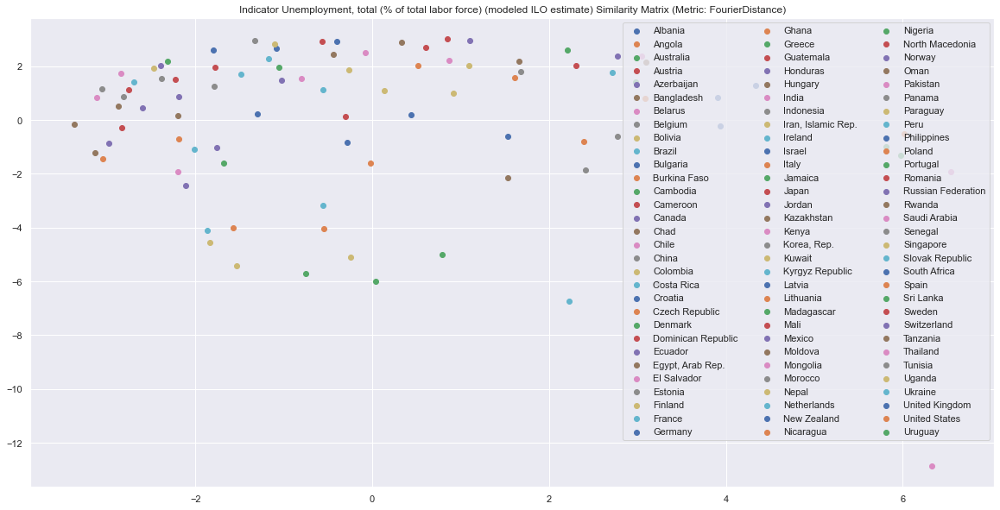

In [20]:
for indicator, similarity in similarity_matrices.items():
    for metric, matrix in similarity.items():
        if np.count_nonzero(np.isnan(matrix)) == 0:
            plot_sim_matrix(indicator, metric, matrix)

### All matrices

In [21]:
data = []
for indicator, similarity in similarity_matrices.items():
    for metric, matrix in similarity.items():
        if np.count_nonzero(np.isnan(matrix)) == 0:
            data.append(matrix)

In [22]:
matrices_stacked = np.stack([matrix.values for matrix in data])

In [23]:
matrices_stacked.shape

(86, 93, 93)

In [24]:
matrices_mean = np.mean(matrices_stacked, axis=0)

In [25]:
matrices_mean.shape

(93, 93)

In [26]:
np.count_nonzero(np.isnan(matrices_mean))

0

In [27]:
transformed = MDS(n_components=2).fit_transform(matrices_mean)

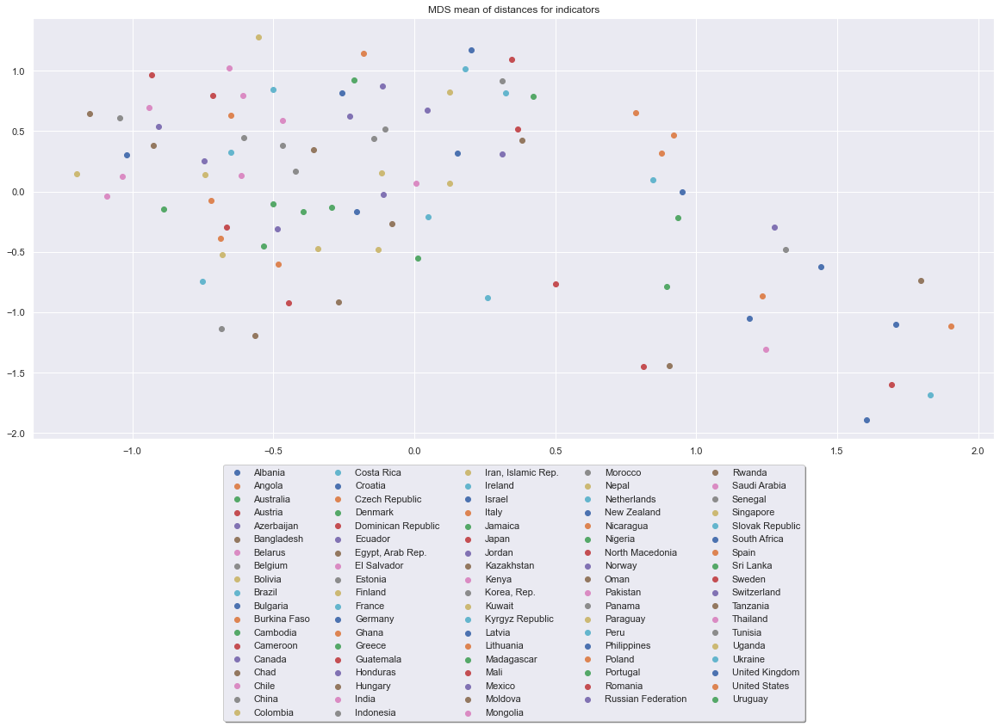

In [28]:
figure = plt.figure(figsize=(20, 10))
ax = plt.subplot(111)

for i in range(transformed.shape[0]):
    plt.scatter(*transformed[i], label=matrix.index.values[i])

box = ax.get_position()
ax.set_position([box.x0, box.y0 + box.height * 0.1, box.width, box.height * 0.9])
ax.legend(
    loc="upper center", bbox_to_anchor=(0.5, -0.05), fancybox=True, shadow=True, ncol=5
)

plt.title("MDS mean of distances for indicators")
plt.show()